In [ ]:
import tensorflow as tf
import tensorflow_probability as tfp
import numpy as np
import os
import pathlib
import string
import matplotlib.pyplot as plt
from keras import layers, models
tfd = tfp.distributions
import cv2

In [ ]:
height, width, channel = 256, 256, 3
imageInput = layers.Input(shape = (height, width, channel))
condInput_1 = layers.Input(shape = (10, ))
batch_size = 4
padding = 'same'
strides = 1
epochs = 10000
filter = 32
kernel = 3
eta = 1e-5
weight_decay = 1e-10

# Proposing a convolutional neural architecture

In [ ]:
def corrletaion(input, filter, kernel, padding, strides, activation, use_norm):
  x = input
  y = input
  y = layers.Conv2D(filter, kernel_size = kernel, padding = padding, strides = strides,)(y)
  if use_norm:
    y = layers.GroupNormalization(groups=1)(y)
  y = layers.Activation(activation)(y)
  for i in range(1):
    x = layers.Conv2D(filter, kernel_size = kernel, padding = padding, strides = strides,)(x)
    if use_norm:
      x = layers.GroupNormalization(groups=1)(x)
    x = layers.Activation(activation)(x)
    x = layers.Conv2D(filter, kernel_size = kernel, padding = padding, strides = strides, )(x)
    if use_norm:
      x = layers.GroupNormalization(groups=1)(x)
    x = layers.add([x, y])
    x = layers.Activation(activation)(x)
    y = x
  return x

In [ ]:
def encoder(input, filter, kernel, padding, strides, activation, use_norm):
  x = input
  x = corrletaion(x, filter, kernel, padding, strides, activation, use_norm)
  downsample = layers.Conv2D(filter, kernel_size = 1, padding = padding,
                             strides = 2, activation = activation)(x)
  return downsample


In [ ]:
def decoder(input, filter, kernel, padding, strides, activation, use_norm):
  x = input
  x = layers.Conv2DTranspose(filter, kernel_size = kernel, padding = padding,
                             strides = 2,)(x)
  if use_norm:
    x = layers.GroupNormalization(groups = 1)(x)
  x = layers.Activation(activation)(x)
  return x

In [ ]:
class AdaIN(layers.Layer):
    def __init__(self, ep = 1e-10):
        self.ep = ep
        super().__init__()
    def call(self, args):
        c, s = args
        mean_c, stddev_c = tf.nn.moments(c, axes = (1, 2), keepdims = True)
        mean_s, stddev_s = tf.nn.moments(s, axes = (1, 2), keepdims = True)
        stddev_c = tf.sqrt(stddev_c + self.ep)
        stddev_s = tf.sqrt(stddev_s + self.ep)
        c = stddev_s*((c - mean_c)/stddev_c) + mean_s
        return c

In [ ]:
def reshape(input, size):
    x = layers.Dense(size[0]*size[1]*size[2])(input)
    x = layers.Reshape((size[0], size[1], size[2]))(x)
    return x

# Propose generator architecture

In [ ]:
def UNET(input, inputCond1,
         filter, kernel, padding, strides, activation, use_norm):
  con1 = encoder(input, filter, kernel, padding, strides, activation, use_norm)
  con2= encoder(con1, filter*2, kernel, padding, strides, activation, use_norm)
  con3 = encoder(con2, filter*4, kernel, padding, strides, activation, use_norm)
  con4 = encoder(con3, filter*8, kernel, padding, strides, activation, use_norm)
  con5 = encoder(con4, filter*16, kernel, padding, strides, activation, use_norm)
  con6 = encoder(con5, filter*32, kernel, padding, strides, activation, use_norm)
  x = layers.Flatten()(con6)
  x = layers.Dense(70, name = 'latent_space')(x)
  x = layers.concatenate([x, inputCond1])
  x = layers.Dense(8*8*1024)(x)
  x = layers.Reshape((8, 8, 1024))(x)
  up2 = decoder(x, filter*16, kernel, padding, strides, activation, False)
  y1 = reshape(inputCond1, [up2.shape[1],up2.shape[2],up2.shape[3]])
  up2 = AdaIN()([up2, y1])
  up3 = decoder(up2, filter*8, kernel, padding, strides, activation, False)
  y1 = reshape(inputCond1, [up3.shape[1],up3.shape[2],up3.shape[3]])
  up3 = AdaIN()([up3, y1])
  up4 = decoder(up3, filter*4, kernel, padding, strides, activation, False)
  y1 = reshape(inputCond1, [up4.shape[1],up4.shape[2],up4.shape[3]])
  up4 = AdaIN()([up4, y1])
  up5 = decoder(up4, filter*2, kernel, padding, strides, activation, use_norm)
  up6 = decoder(up5, filter, kernel, padding, strides, activation, use_norm)
  output = layers.Conv2DTranspose(3, kernel_size = 3, padding = padding, strides = strides,)(up6)
  output = layers.Activation('sigmoid')(output)
  m = models.Model(inputs = [input, inputCond1],
                   outputs = output, name = 'UNET')
  return m

In [ ]:
unet = UNET(imageInput, condInput_1,
         filter, kernel, padding, strides, 'relu', True)
unet.summary()

Model: "UNET"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 256, 256, 32  896         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 group_normalization_1 (GroupNo  (None, 256, 256, 32  64         ['conv2d_1[0][0]']               
 rmalization)                   )                                                              

In [ ]:
unet_another = models.Model(inputs = unet.inputs,
                            outputs = [unet.outputs[0], unet.get_layer('latent_space').output])
unet_another.load_weights('/kaggle/working/unet.h5')

In [ ]:
unet_another.outputs

[<KerasTensor: shape=(None, 256, 256, 3) dtype=float32 (created by layer 'activation_23')>,
 <KerasTensor: shape=(None, 70) dtype=float32 (created by layer 'latent_space')>]

# Propose a discriminant structure

In [ ]:
def discriminator(input, filter, kernel, padding, strides, activation, use_norm):
  x = input
  con1 = encoder(x, filter, kernel, padding, strides, activation, use_norm)
  con2= encoder(con1, filter*2, kernel, padding, strides, activation, use_norm)
  con3 = encoder(con2, filter*4, kernel, padding, strides, activation, use_norm)
  con4 = encoder(con3, filter*8, kernel, padding, strides, activation, use_norm)
  con5 = encoder(con4, filter*16, kernel, padding, strides, activation, use_norm)
  con6 = encoder(con5, filter*32, kernel, padding, strides, activation, use_norm)
  output = layers.Conv2D(1, kernel_size = 3, padding = 'same', strides = 1)(con6)
  output1 = layers.Conv2D(1, kernel_size = 3, padding = 'same', strides = 1)(con5)
  output2 = layers.Conv2D(1, kernel_size = 3, padding = 'same', strides = 1)(con4)
  f = layers.Flatten()(con6)
  output3 = layers.Dense(10,)(f)
  m = models.Model(inputs = input, outputs = [output, output1, output2, output3])
  m.load_weights('/kaggle/working/DD.h5')
  m.compile(loss = ['mse', 'mse','mse', 'mae'],
            loss_weights = [1, 1, 1, 0.5],
            optimizer = tf.keras.optimizers.RMSprop(learning_rate=eta,
                                                                  weight_decay = weight_decay))
  return m

In [ ]:
D = discriminator(layers.Input(shape = (256, 256, 3)), filter, kernel, padding, strides, 'LeakyReLU', False)
D.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_25 (Conv2D)             (None, 256, 256, 32  896         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 activation_25 (Activation)     (None, 256, 256, 32  0           ['conv2d_25[0][0]']              
                                )                                                           

In [ ]:
def loss_normal_dist(y_true, y_pred):
    norm_dist = tfd.Normal(loc = 0, scale = 1)
    return - norm_dist.log_prob(y_pred)

> Here, the more we lose the regeneration of the same image whenever it affects the control of the resulting form, that is, when the loss of the regeneration of the image is very high. In this case, the features will not be changed, but rather the same person will be preserved, but with a slight change represented by the color of the hair, for example, or making the person He smiles or closes his mouth.
> Therefore, I set the loss to 0.75 after conducting the experiments. This value guarantees that we will obtain the same person, but with a change in the features.

In [ ]:
D.trainable = False
GANinputs = [imageInput, condInput_1]
outputImage, latent_space = unet_another(GANinputs)
GAN = models.Model(inputs = GANinputs,
                      outputs = [D(outputImage), outputImage, latent_space])
GAN.compile(loss = ['mse','mse','mse', 'mae', 'mae', loss_normal_dist],
            loss_weights = [1, 1, 1, 0.5, 0.75, 0.1],
            optimizer = tf.keras.optimizers.RMSprop(learning_rate=eta,
                                                    weight_decay = weight_decay))
GAN.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_2 (InputLayer)           [(None, 10)]         0           []                               
                                                                                                  
 model (Functional)             [(None, 256, 256, 3  49405385    ['input_1[0][0]',                
                                ),                                'input_2[0][0]']                
                                 (None, 70)]                                                

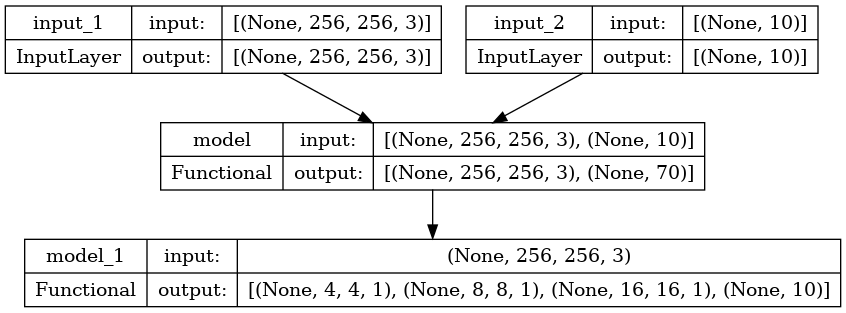

In [ ]:
tf.keras.utils.plot_model(GAN, show_shapes = True)

> Note: A multivariate uniform distribution was used.
> Note: The 10 dimensions were not included in the latent space, but rather had a fundamental role in influencing the resulting shape so that the outputs of the generative convolutional structure were normalized according to the values ​​of the 10 dimensions inputs.

In [ ]:
uniform_dist = tfd.Uniform(low = -1, high=[1 for i in range(10)])
uniform_dist.sample(3)

<tf.Tensor: shape=(3, 10), dtype=float32, numpy=
array([[-0.07585216,  0.27519202,  0.69965696, -0.29042912, -0.5124216 ,
        -0.85518503, -0.09287882,  0.54465437,  0.4765234 , -0.5676608 ],
       [-0.16856647,  0.3582964 ,  0.74557567, -0.56943965,  0.2960546 ,
         0.14375162,  0.6206622 ,  0.53466105,  0.1923263 ,  0.39717078],
       [-0.5952461 , -0.3638115 ,  0.26568723,  0.60977054,  0.15434432,
         0.47734165,  0.28489065, -0.94645286,  0.27397013, -0.3949113 ]],
      dtype=float32)>

In [ ]:
def get_samples(sampleShape, uniform_dist):
  return uniform_dist.sample(sampleShape)

In [ ]:
def ones(shape):
  return tf.ones(shape = shape)
def zeros(shape):
  return tf.zeros(shape = shape)

In [ ]:
def read_images(pathes):
    images = []
    for img in pathes:
        img = cv2.imread(str(img))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (256, 256))
        img = img/255
        images.append(img)
    return np.array(images)

In [ ]:
images_path = np.array(sorted(list(pathlib.Path('/kaggle/input/person-face-dataset-thispersondoesnotexist/thispersondoesnotexist.10k').glob('*.*'))))

In [ ]:
def generate_images(batch_size):
    images = read_images(images_path[np.random.randint(len(images_path) - 1, size = (batch_size,))])
    return images

In [ ]:
def show_samples(imgs):
  batch_size = 8
  latent_g = tf.ones(shape = (batch_size, 256, 256, 3))*imgs[0]
  images, _ = unet_another.predict([latent_g,
                      uniform_dist.sample((batch_size))], verbose = 0)
  images = tf.squeeze(images)
  plt.figure(figsize = (2, 2))
  plt.imshow(imgs[0])
  plt.figure(figsize = (12, 2))
  for i in range(8):
    plt.subplot(1, 8, (i + 1))
    plt.imshow(images[i])
  plt.show()

In [ ]:
def save_weight(D, unet):
    D.save_weights('/kaggle/working/DD.h5')
    unet.save_weights('/kaggle/working/unet.h5')

In [ ]:
GAN.inputs

[<KerasTensor: shape=(None, 256, 256, 3) dtype=float32 (created by layer 'input_1')>,
 <KerasTensor: shape=(None, 10) dtype=float32 (created by layer 'input_2')>]

In [ ]:
GAN.outputs

[<KerasTensor: shape=(None, 4, 4, 1) dtype=float32 (created by layer 'model_1')>,
 <KerasTensor: shape=(None, 8, 8, 1) dtype=float32 (created by layer 'model_1')>,
 <KerasTensor: shape=(None, 16, 16, 1) dtype=float32 (created by layer 'model_1')>,
 <KerasTensor: shape=(None, 10) dtype=float32 (created by layer 'model_1')>,
 <KerasTensor: shape=(None, 256, 256, 3) dtype=float32 (created by layer 'model')>,
 <KerasTensor: shape=(None, 70) dtype=float32 (created by layer 'model')>]

In [ ]:
normalDist = tfd.Normal(loc = 0, scale = 1)

> Note: The training took place for approximately 35 hours, meaning you must train for a large number of epochs.

In [ ]:
patchGan1 = (batch_size, 4, 4, 1)
patchGan2 = (batch_size, 8, 8, 1)
patchGan3 = (batch_size, 16, 16, 1)
for i in range(epochs):
    images = generate_images(batch_size)
    real_cond_1_samples = get_samples((batch_size), uniform_dist)
    fake_cond_1_samples = get_samples((batch_size), uniform_dist)
    all_cond_1_Samples = np.vstack([real_cond_1_samples, fake_cond_1_samples])
    real_tags = ones(patchGan1)
    fake_tags = zeros(patchGan1)
    allTags = np.vstack([real_tags, fake_tags])
    fake_images, _ = unet_another.predict([images, fake_cond_1_samples], verbose = 0)
    allImages = np.vstack([images, tf.squeeze(fake_images)])
    dloss, d1, d2, d3, d4  = D.train_on_batch([allImages],[np.vstack([ones(patchGan1),
                                                              zeros(patchGan1)]),
                                                   np.vstack([ones(patchGan2),
                                                              zeros(patchGan2)]),
                                                   np.vstack([ones(patchGan3),
                                                              zeros(patchGan3)]),
                                                   all_cond_1_Samples])
    images = generate_images(batch_size)
    fake_as_real_cond_1_samples = get_samples((batch_size), uniform_dist)
    fake_as_real_cond_2_samples = get_samples((batch_size), uniform_dist)
    all_loss, loss_d1, loss_d2, loss_d3, loss_cond1, outputImage_loss, latent_loss = GAN.train_on_batch([images, fake_as_real_cond_1_samples,
                                                                      ],
                                                                      [[ones(patchGan1),
                                                                        ones(patchGan2),
                                                                        ones(patchGan3),
                                                                        fake_as_real_cond_1_samples,
                                                                        ], images, ones(patchGan1)])
    if i%500 == 0:
        print('start save weights')
        save_weight(D,unet_another)
        print('weights saved')
    if i%200 == 0:
        print('Epoch: {}/{}'.format(i, epochs))
        str_ = 'D_loss: {}, loss_G: {}, Gloss_cond1: {}, \n Dloss_cond1: {}, outputImage_loss: {}, latent_space_loss: {}'.format((d1 + d2 + d3)/3,
                                                                                  (loss_d1 + loss_d2 + loss_d3)/3,
                                                                                  loss_cond1,d4, outputImage_loss, latent_loss)
        print(str_)
#     if i%500 == 0:
#         print('Samples')
#         show_samples(generate_images(8))
#         show_samples(generate_images(8))

start save weights
weights saved
Epoch: 0/10000
D_loss: 0.17258497575918832, loss_G: 0.46300103267033893, Gloss_cond1: 0.1654146909713745, 
 Dloss_cond1: 0.3144761025905609, outputImage_loss: 0.2210550159215927, latent_space_loss: 1.0799739360809326
Epoch: 200/10000
D_loss: 0.17404691750804582, loss_G: 0.4345215708017349, Gloss_cond1: 0.11695331335067749, 
 Dloss_cond1: 0.2903006076812744, outputImage_loss: 0.2333112210035324, latent_space_loss: 0.9516242146492004
Epoch: 400/10000
D_loss: 0.16635949661334357, loss_G: 0.7272809942563375, Gloss_cond1: 0.10973744094371796, 
 Dloss_cond1: 0.3527701497077942, outputImage_loss: 0.16314327716827393, latent_space_loss: 0.9455220103263855
start save weights
weights saved
Epoch: 600/10000
D_loss: 0.18178719778855643, loss_G: 0.48725950717926025, Gloss_cond1: 0.17346632480621338, 
 Dloss_cond1: 0.37114596366882324, outputImage_loss: 0.1859128773212433, latent_space_loss: 1.1780632734298706
Epoch: 800/10000
D_loss: 0.17722249776124954, loss_G: 0.4

In [ ]:
save_weight(D,
            unet_another)

# Results:
## Samples of the results reached.

In [ ]:
def generate_samples_new(image):
  batch_size = 64
  latent_g = tf.ones(shape = (batch_size, 256, 256, 3))*image
  cond = tfd.Uniform(low = -1, high=[1 for i in range(10)])
  images = unet.predict([latent_g, cond.sample((64))], verbose = 0)
  plt.figure(figsize = (3, 3))
  plt.title('Original face')
  plt.imshow(image)
  plt.figure(figsize = (12, 12))
#   plt.title('Identical twins generated from the basic facial image')
  for i in range(64):
      plt.subplot(8, 8, (i + 1))
      plt.imshow(images[i])
  plt.show()

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


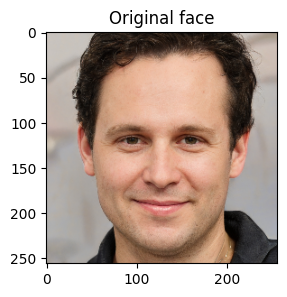

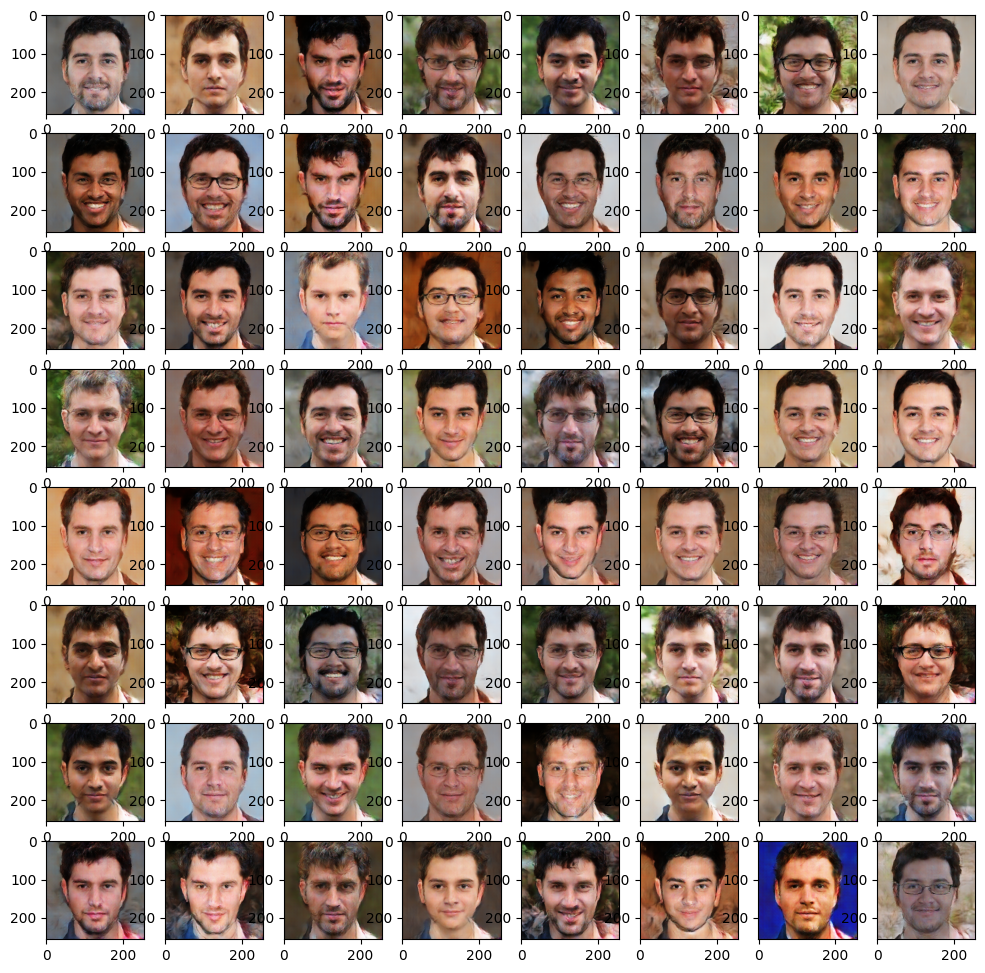

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_32/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


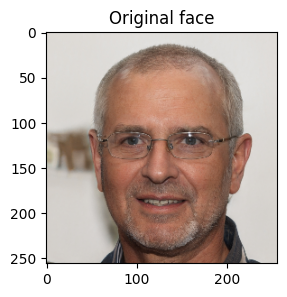

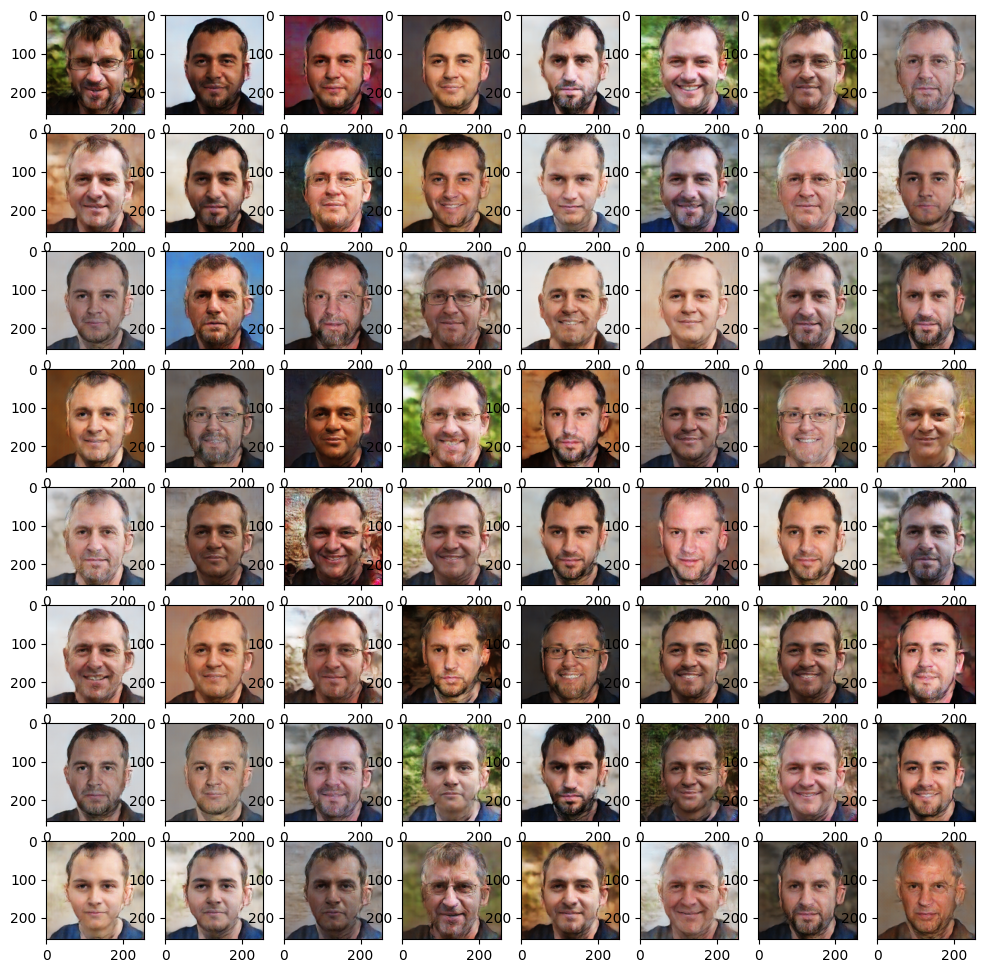

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


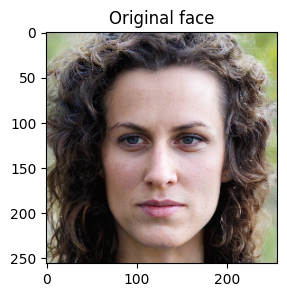

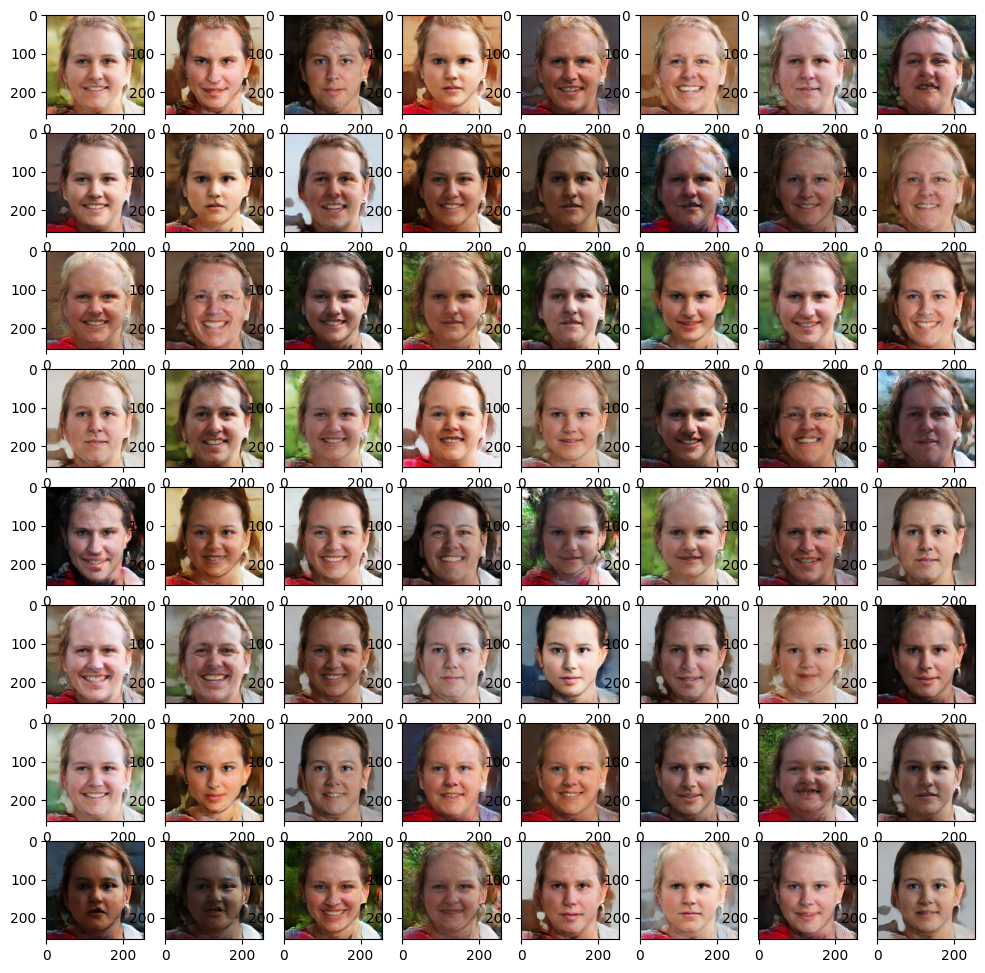

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


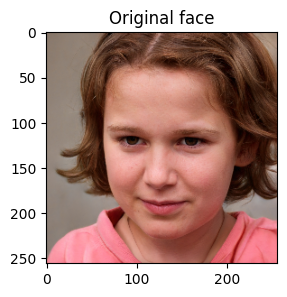

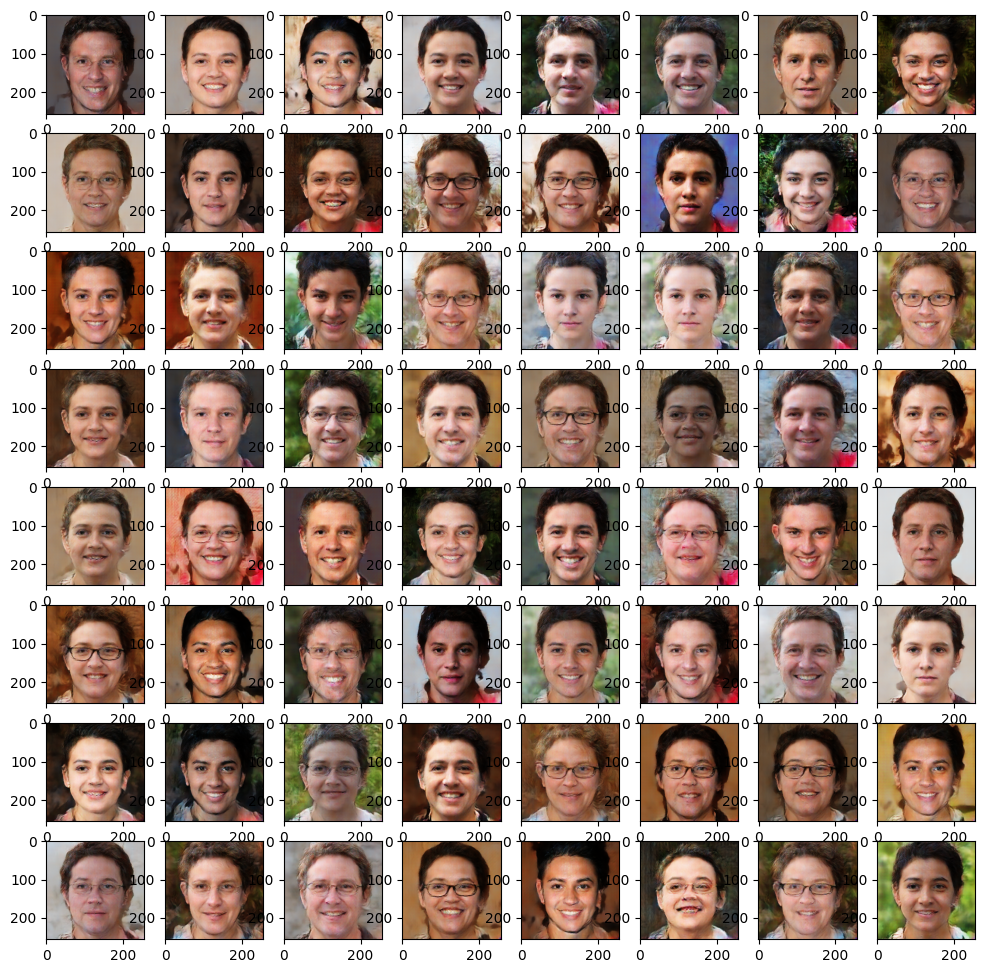

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


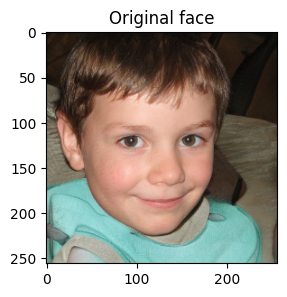

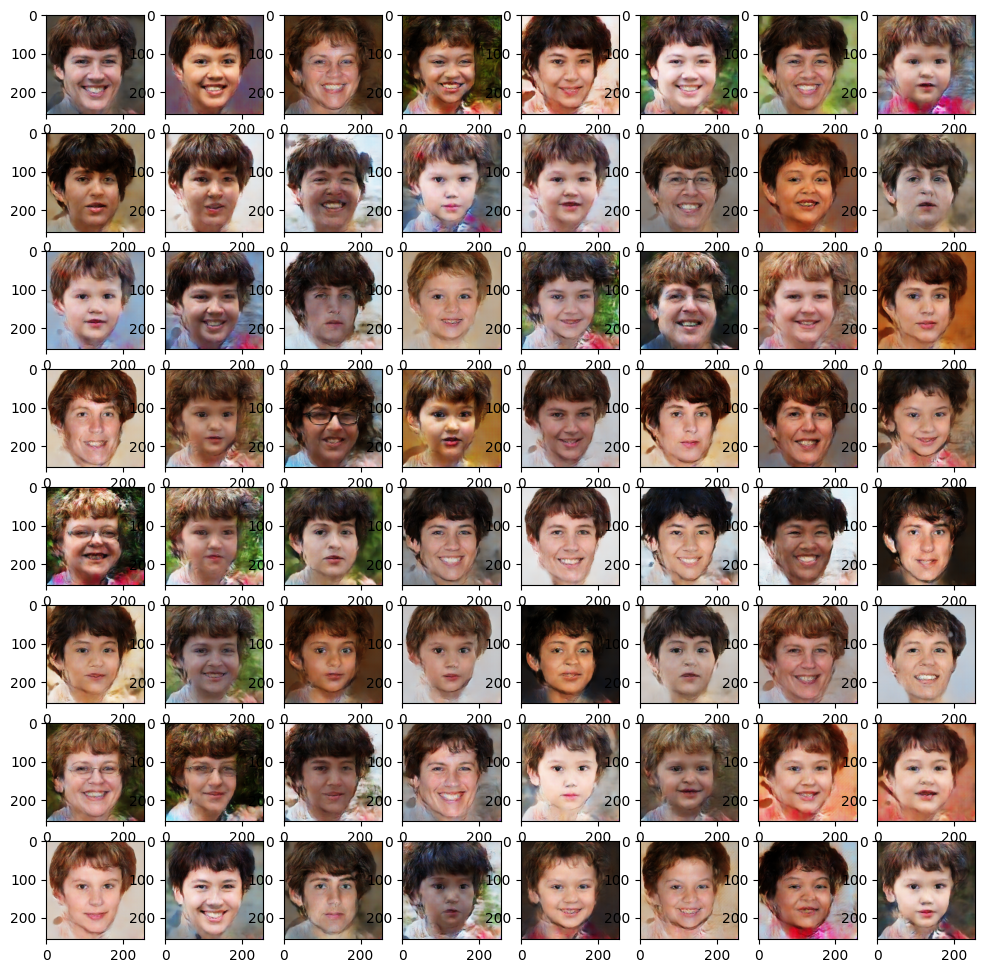

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


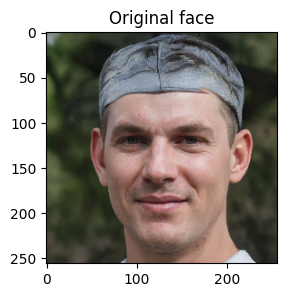

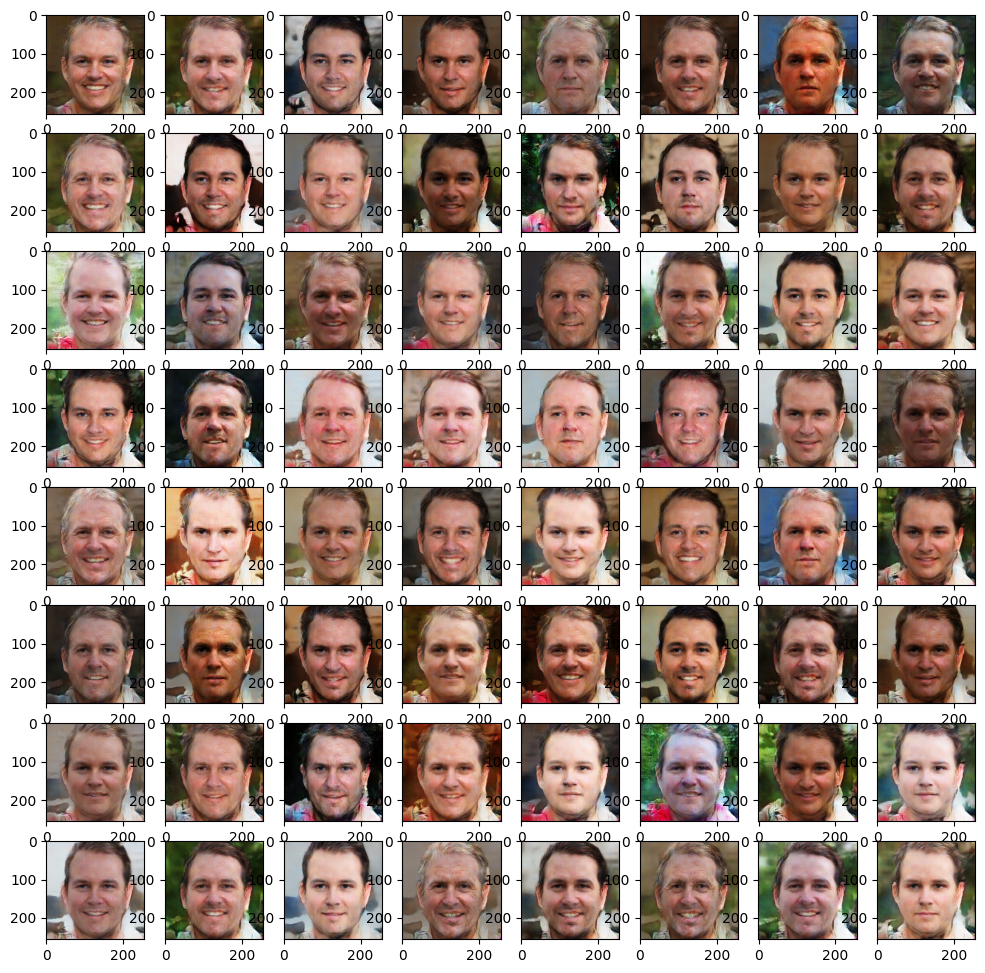

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


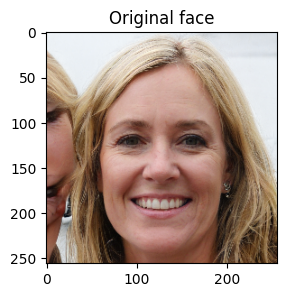

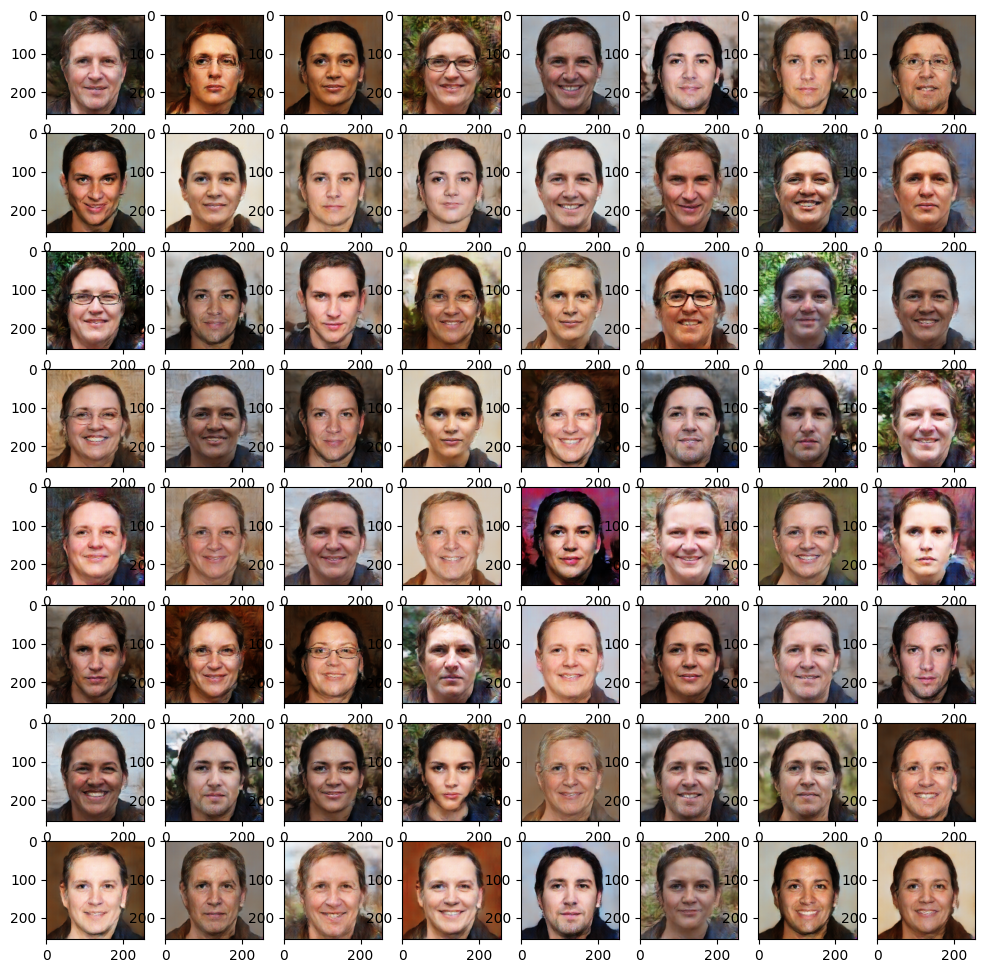

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


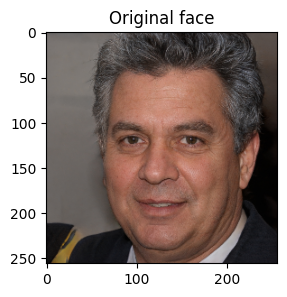

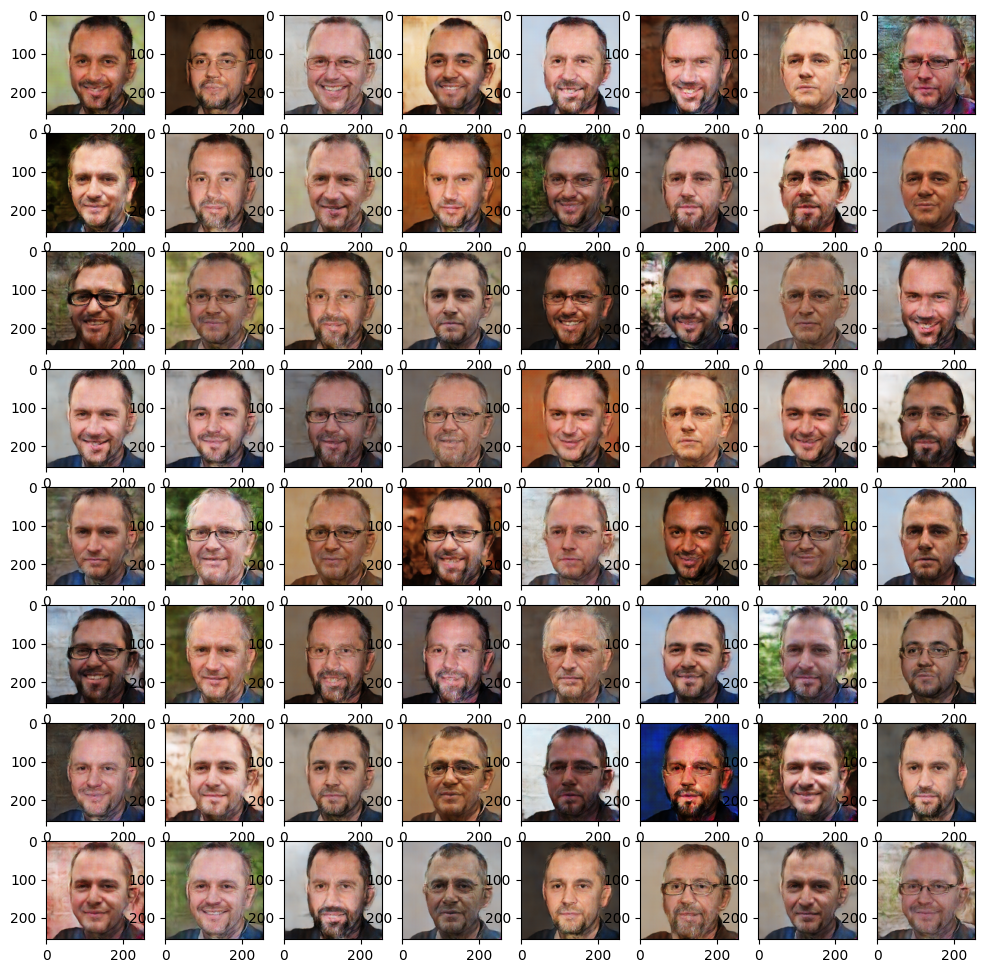

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


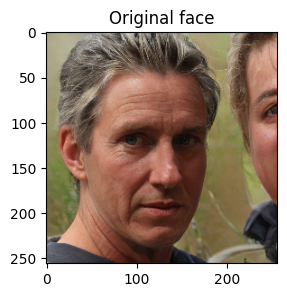

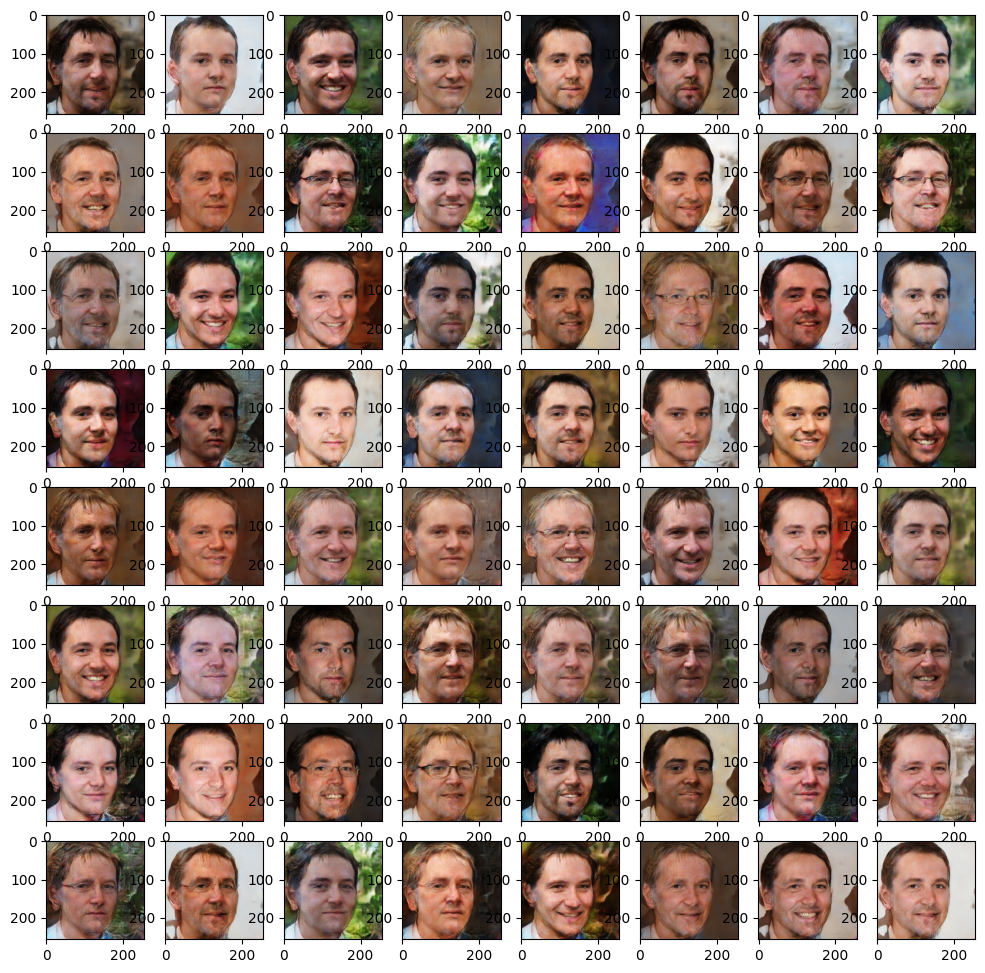

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


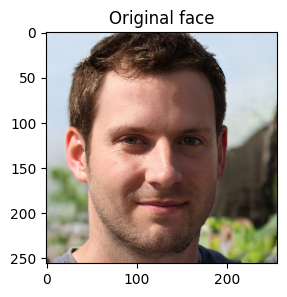

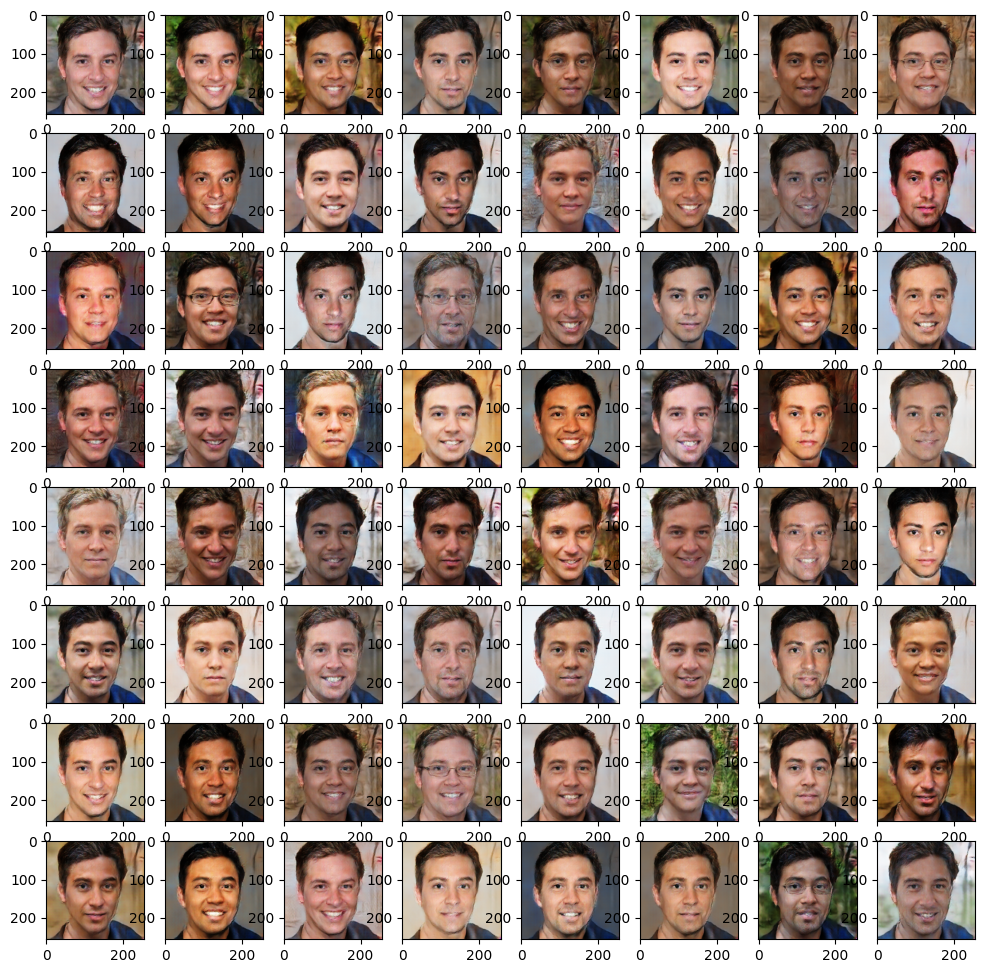

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


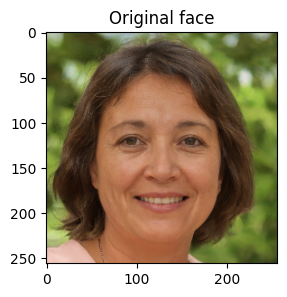

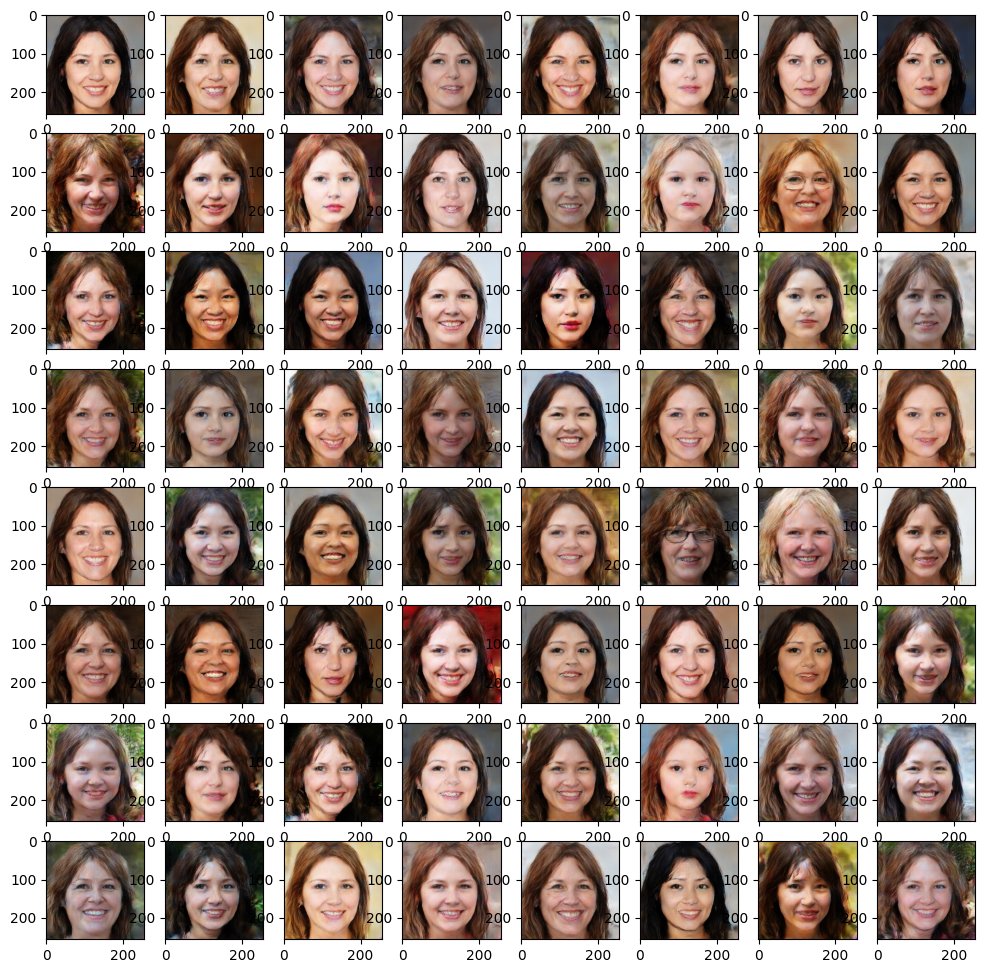

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

/tmp/ipykernel_190660/1759700493.py:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8, 8, (i + 1))


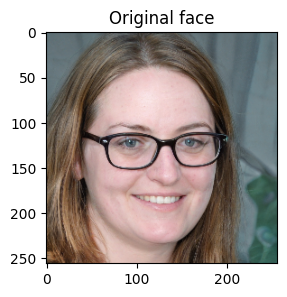

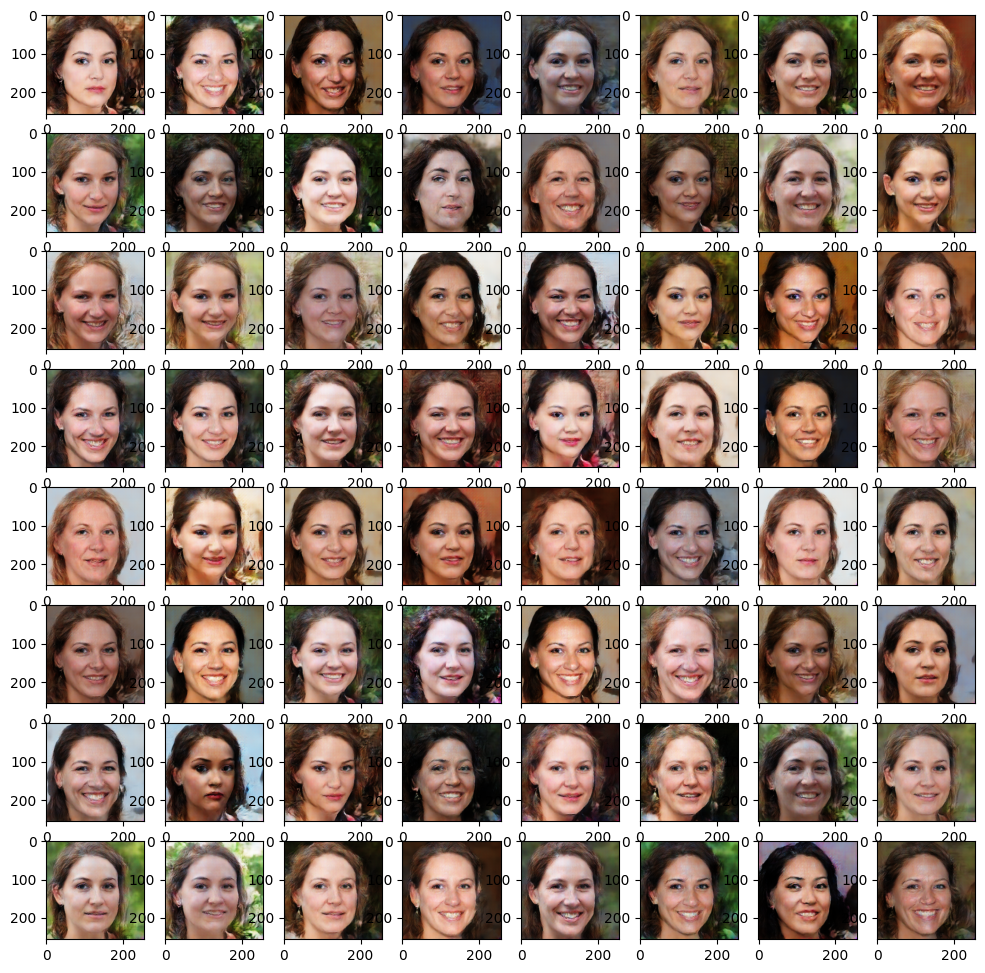

In [ ]:
generate_samples_new(tf.squeeze(generate_images(1)).numpy())

> Note: The vast majority of the data sets that were used include pictures of people with white skin, and therefore there are a small number of black people in the data set, and even within the data set there is not a large number of pictures of Asian people.
> Therefore, you can retrain with a larger data set than the one I used